In [54]:
# all subjects #
from importFunctions import *
import resp_cleaning as rc
import matplotlib.pyplot as plt
import json
import importlib
from os.path import exists
import glob
import shutil
import pandas as pd
import numpy as np
import antropy

bids = "/mnt/raid0/scratch/BIDS/"
saveFile = f"{bids}derivatives/summaries/rest/physio_metrics/rest_breathmetrics_summary.tsv"
qcFolder = "/home/leah/Git/physio_correction/respiratory/rest/qc_figs/"

subList = os.listdir(bids)
subList = [sub for sub in subList if sub.startswith("sub")]
subList = list(set(subList))
subList.sort()
subList = [sub[4:8] for sub in subList] # subject numbers

rejected_subjects = ["0111", "0132", "0229", "0348", "0437", "0516", "0533"]

corrected_subjects = ["0024", "0031", "0040", "0046", "0047", "0055", "0057", "0063", "0074", "0085", "0092", "0097", "0099", "0100", "0110", "0145", "0163", "0171", "0181", "0184", "0192", "0198", "0207", "0208", "0217", "0218", "0265", "0267", "0280", "0217", "0218", "0265", "0267", "0280", "0283", "0292", "0300", "0311", "0312", "0324", "0339", "0353", "0363", "0370", "0389", "0395", "0396", "0403", "0415", "0419", "0423", "0428", "0430", "0438", "0495", "0544", "0549", "0550", "0555", "0558", "0559", "0560", "0564", "0600", "0613", "0627"]

breath_metrics = pd.DataFrame()

#subList = ['0265']

for sub in subList:

    if sub in rejected_subjects:
        continue

    # List files in subjects BIDS folder
    file_list = glob.glob(bids + f"sub-{sub}/" + "**/*.*", recursive=True)

    # find the respiratory recording path (can contain EGG, cheek PPG, & respiration belt (from exg) - VMP1, respiration belt (from scanner) - VMP2)
    # VMP1:
    if int(sub) <= 262:
        sfreq = 1000
        resp_name = "RESP"
        exg_files = [f for f in file_list if f.endswith(
            "rest_run-001_recording-exg_physio.tsv.gz")]
        json_files = [f for f in file_list if f.endswith(
            "rest_run-001_recording-exg_physio.json")]
    # VMP2
    elif int(sub) >= 263:
        sfreq = 50
        resp_name = "respiratory"
        exg_files = [f for f in file_list if f.endswith(
            "rest_run-001_recording-respiratory_physio.tsv.gz")]
        json_files = [f for f in file_list if f.endswith(
            "rest_run-001_recording-respiratory_physio.json")]

    if len(exg_files) == 1 and len(json_files) == 1:
        exg_file = exg_files[0]
        json_file = json_files[0]
    else:
        print(
            f"Subject {sub} - no data file / too many data files (number of tsv files ={len(exg_files)}, json = {len(json_files)})")
        # add sub num & empty/nan to breath_metrics dataframe (for subjects with no respiratory data)
        breath_metrics = breath_metrics.append({'sub':sub,'rr':float("nan"), 'breathDur_mean':float("nan"), 'breathDur_sd':float("nan"),
                            'inspDepth_mean':float("nan"), 'inspDepth_sd':float("nan"), 'expDepth_mean':float("nan"), 'expDepth_sd':float("nan"), 'spectral_entropy':float("nan")}, ignore_index=True)
        continue

    # import files with respiration data
    exg_df = pd.read_csv(f'{exg_file}', compression='gzip', sep='\t', header=None)
    f = open(f'{json_file}')
    json_dict = json.load(f)
    exg_df.columns = json_dict['Columns']
    
    # check if resp signal starts at first TR trigger
    if np.sum(exg_df.loc[:,'trigger']) != 600: # check if sum triggers 600
        print(
        f"Subject {sub} - not 600 TR triggers")
        continue
    first_trig = np.argmax(exg_df.loc[:, 'trigger'].values == 1)  
    last_trig = exg_df.loc[:, 'trigger'][exg_df.loc[:, 'trigger'] == 1].index[-1]  
    exg_df = exg_df.iloc[first_trig:last_trig+1,:] # align with first TR trigger
    

    # select respiration only as dataframe
    if not resp_name in json_dict['Columns']:
        print(
            f"Subject {sub} - no resp in physio file")
        # add sub num & empty/nan to breath_metrics dataframe (for subjects with no respiratory data)
        breath_metrics = breath_metrics.append({'sub':sub,'rr':float("nan"), 'breathDur_mean':float("nan"), 'breathDur_sd':float("nan"),
                            'inspDepth_mean':float("nan"), 'inspDepth_sd':float("nan"), 'expDepth_mean':float("nan"), 'expDepth_sd':float("nan"), 'spectral_entropy':float("nan")}, ignore_index=True)
        continue

    resp_idx = json_dict['Columns'].index(resp_name)
    resp_df = exg_df.iloc[:,resp_idx]
    resp_df = pd.Series.to_frame(resp_df).rename(columns={resp_name: 'respiration'})
    if int(sub) >= 263:
        resp_df = resp_df.interpolate()
    resp_df_zscore = zScore(resp_df)

    ## pre-proc
    filtered = butter_lowpass_filter(resp_df.respiration, 1, sfreq, 4)
    filtered_zscore = butter_lowpass_filter(resp_df_zscore.respiration, 1, sfreq, 4)
    time= np.linspace(0, len(filtered)/sfreq, len(filtered))

    if sub not in corrected_subjects:
        ## get peaks and troughs
        peaks_fmri, troughs_fmri = rc.findPeaksAndTroughs(filtered_zscore, prominence=0.6,  dist=1, sFreq=sfreq)
    # if peak detection was manually corrected - load corrected peaks/troughs
    elif sub in corrected_subjects:
        df = pd.read_csv(f'/home/leah/Git/physio_correction/respiratory/rest/corrected_peaks/{sub}_metrics_corrected.csv')
        peaks = np.fromstring(df.peaks[0][3:-1], dtype=int, sep='  ')
        troughs = np.fromstring(df.troughs[0][3:-1], dtype=int, sep='  ')
        # account for alignment of first/last TR trig
        peaks_fmri = peaks - first_trig
        peaks_fmri = peaks_fmri[peaks_fmri >= 0]
        peaks_fmri = peaks_fmri[(peaks_fmri <= last_trig)]
        
        troughs_fmri = troughs - first_trig
        troughs_fmri = troughs_fmri[troughs_fmri >= 0]
        troughs_fmri = troughs_fmri[(troughs_fmri <= last_trig)]
        
    # get individual breaths info
    breaths = rc.breathDF(peaks_fmri, troughs_fmri, filtered, sfreq, 'peak_based')
    
    # save breaths details for each subj
    breaths.to_csv(f"/mnt/raid0/scratch/BIDS/derivatives/physio/resp/rest/BreathDetails/{sub}_breaths_timing_range.csv")   # save csv each subj


/home/leah/.local/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3472: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  breaths = breaths.append(thisBreath, ignore_index=True)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  breaths = breaths.append(thisBreath, ignore_index=True)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a futu

Subject 0021 - no data file / too many data files (number of tsv files =0, json = 0)


/home/leah/.local/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3472: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  breaths = breaths.append(thisBreath, ignore_index=True)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  breaths = breaths.append(thisBreath, ignore_index=True)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a futu

Subject 0156 - no data file / too many data files (number of tsv files =0, json = 0)


/home/leah/.local/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3472: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  breaths = breaths.append(thisBreath, ignore_index=True)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  breaths = breaths.append(thisBreath, ignore_index=True)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a futu

Subject 0169 - no data file / too many data files (number of tsv files =0, json = 0)
Subject 0170 - no data file / too many data files (number of tsv files =0, json = 0)


/home/leah/.local/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3472: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  breaths = breaths.append(thisBreath, ignore_index=True)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  breaths = breaths.append(thisBreath, ignore_index=True)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a futu

Subject 0187 - no data file / too many data files (number of tsv files =0, json = 0)


/home/leah/.local/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3472: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  breaths = breaths.append(thisBreath, ignore_index=True)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  breaths = breaths.append(thisBreath, ignore_index=True)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a futu

Subject 0200 - no data file / too many data files (number of tsv files =0, json = 0)


/home/leah/.local/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3472: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  breaths = breaths.append(thisBreath, ignore_index=True)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  breaths = breaths.append(thisBreath, ignore_index=True)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a futu

Subject 0204 - no data file / too many data files (number of tsv files =0, json = 0)


/home/leah/.local/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3472: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  breaths = breaths.append(thisBreath, ignore_index=True)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  breaths = breaths.append(thisBreath, ignore_index=True)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a futu

Subject 0221 - no data file / too many data files (number of tsv files =0, json = 0)


/home/leah/.local/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3472: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  breaths = breaths.append(thisBreath, ignore_index=True)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  breaths = breaths.append(thisBreath, ignore_index=True)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a futu

Subject 0223 - no data file / too many data files (number of tsv files =0, json = 0)


/home/leah/.local/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3472: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  breaths = breaths.append(thisBreath, ignore_index=True)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  breaths = breaths.append(thisBreath, ignore_index=True)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a futu

Subject 0226 - not 600 TR triggers


/home/leah/.local/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3472: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  breaths = breaths.append(thisBreath, ignore_index=True)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  breaths = breaths.append(thisBreath, ignore_index=True)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a futu

Subject 0236 - no data file / too many data files (number of tsv files =0, json = 0)
Subject 0237 - no data file / too many data files (number of tsv files =0, json = 0)


/home/leah/.local/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3472: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  breaths = breaths.append(thisBreath, ignore_index=True)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  breaths = breaths.append(thisBreath, ignore_index=True)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a futu

Subject 0246 - no data file / too many data files (number of tsv files =0, json = 0)


/home/leah/.local/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3472: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  breaths = breaths.append(thisBreath, ignore_index=True)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  breaths = breaths.append(thisBreath, ignore_index=True)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a futu

Subject 0252 - no data file / too many data files (number of tsv files =0, json = 0)


/home/leah/.local/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3472: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  breaths = breaths.append(thisBreath, ignore_index=True)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  breaths = breaths.append(thisBreath, ignore_index=True)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a futu

Subject 0273 - not 600 TR triggers


/home/leah/.local/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3472: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  breaths = breaths.append(thisBreath, ignore_index=True)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  breaths = breaths.append(thisBreath, ignore_index=True)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a futu

Subject 0282 - no data file / too many data files (number of tsv files =0, json = 0)


/home/leah/.local/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3472: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  breaths = breaths.append(thisBreath, ignore_index=True)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  breaths = breaths.append(thisBreath, ignore_index=True)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a futu

Subject 0287 - not 600 TR triggers


/home/leah/.local/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3472: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  breaths = breaths.append(thisBreath, ignore_index=True)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  breaths = breaths.append(thisBreath, ignore_index=True)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a futu

Subject 0340 - not 600 TR triggers


/home/leah/.local/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3472: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  breaths = breaths.append(thisBreath, ignore_index=True)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  breaths = breaths.append(thisBreath, ignore_index=True)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a futu

Subject 0364 - no data file / too many data files (number of tsv files =0, json = 0)


/home/leah/.local/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3472: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  breaths = breaths.append(thisBreath, ignore_index=True)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  breaths = breaths.append(thisBreath, ignore_index=True)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a futu

Subject 0398 - no data file / too many data files (number of tsv files =0, json = 0)


/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  breaths = breaths.append(thisBreath, ignore_index=True)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  breaths = breaths.append(thisBreath, ignore_index=True)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  breaths = breaths.append(thisBreath, ignore_index=True)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  breaths = breaths.append(thi

Subject 0445 - not 600 TR triggers
Subject 0446 - not 600 TR triggers


/home/leah/.local/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3472: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  breaths = breaths.append(thisBreath, ignore_index=True)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  breaths = breaths.append(thisBreath, ignore_index=True)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a futu

Subject 0451 - no data file / too many data files (number of tsv files =0, json = 0)


/tmp/ipykernel_2721651/3874914106.py:65: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  breath_metrics = breath_metrics.append({'sub':sub,'rr':float("nan"), 'breathDur_mean':float("nan"), 'breathDur_sd':float("nan"),
/home/leah/.local/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3472: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  breaths = breaths.append(thisBreath, ignore_index=True)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is depr

Subject 0483 - no data file / too many data files (number of tsv files =0, json = 0)


/tmp/ipykernel_2721651/3874914106.py:65: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  breath_metrics = breath_metrics.append({'sub':sub,'rr':float("nan"), 'breathDur_mean':float("nan"), 'breathDur_sd':float("nan"),
/home/leah/.local/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3472: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  breaths = breaths.append(thisBreath, ignore_index=True)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is depr

Subject 0518 - not 600 TR triggers


/home/leah/.local/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3472: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  breaths = breaths.append(thisBreath, ignore_index=True)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  breaths = breaths.append(thisBreath, ignore_index=True)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a futu

Subject 0573 - no data file / too many data files (number of tsv files =0, json = 0)


/home/leah/.local/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3472: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  breaths = breaths.append(thisBreath, ignore_index=True)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  breaths = breaths.append(thisBreath, ignore_index=True)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a futu

Subject 0584 - no data file / too many data files (number of tsv files =0, json = 0)


/tmp/ipykernel_2721651/3874914106.py:65: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  breath_metrics = breath_metrics.append({'sub':sub,'rr':float("nan"), 'breathDur_mean':float("nan"), 'breathDur_sd':float("nan"),
/home/leah/.local/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3472: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  breaths = breaths.append(thisBreath, ignore_index=True)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is depr

Subject 0595 - no data file / too many data files (number of tsv files =0, json = 0)


/home/leah/.local/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3472: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  breaths = breaths.append(thisBreath, ignore_index=True)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  breaths = breaths.append(thisBreath, ignore_index=True)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a futu

Subject 0618 - no data file / too many data files (number of tsv files =0, json = 0)


/tmp/ipykernel_2721651/3874914106.py:65: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  breath_metrics = breath_metrics.append({'sub':sub,'rr':float("nan"), 'breathDur_mean':float("nan"), 'breathDur_sd':float("nan"),
/home/leah/.local/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3472: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  breaths = breaths.append(thisBreath, ignore_index=True)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is depr

Subject 0634 - no data file / too many data files (number of tsv files =0, json = 0)
Subject 0635 - no data file / too many data files (number of tsv files =0, json = 0)
Subject 0637 - no data file / too many data files (number of tsv files =0, json = 0)


/tmp/ipykernel_2721651/3874914106.py:65: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  breath_metrics = breath_metrics.append({'sub':sub,'rr':float("nan"), 'breathDur_mean':float("nan"), 'breathDur_sd':float("nan"),
/home/leah/.local/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3472: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  breaths = breaths.append(thisBreath, ignore_index=True)
/home/leah/Git/physio_correction/respiratory/resp_cleaning.py:84: FutureWarning: The frame.append method is depr

Subject 0641 - no data file / too many data files (number of tsv files =0, json = 0)
Subject 0642 - no data file / too many data files (number of tsv files =0, json = 0)


/tmp/ipykernel_2721651/3874914106.py:65: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  breath_metrics = breath_metrics.append({'sub':sub,'rr':float("nan"), 'breathDur_mean':float("nan"), 'breathDur_sd':float("nan"),
/tmp/ipykernel_2721651/3874914106.py:65: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  breath_metrics = breath_metrics.append({'sub':sub,'rr':float("nan"), 'breathDur_mean':float("nan"), 'breathDur_sd':float("nan"),


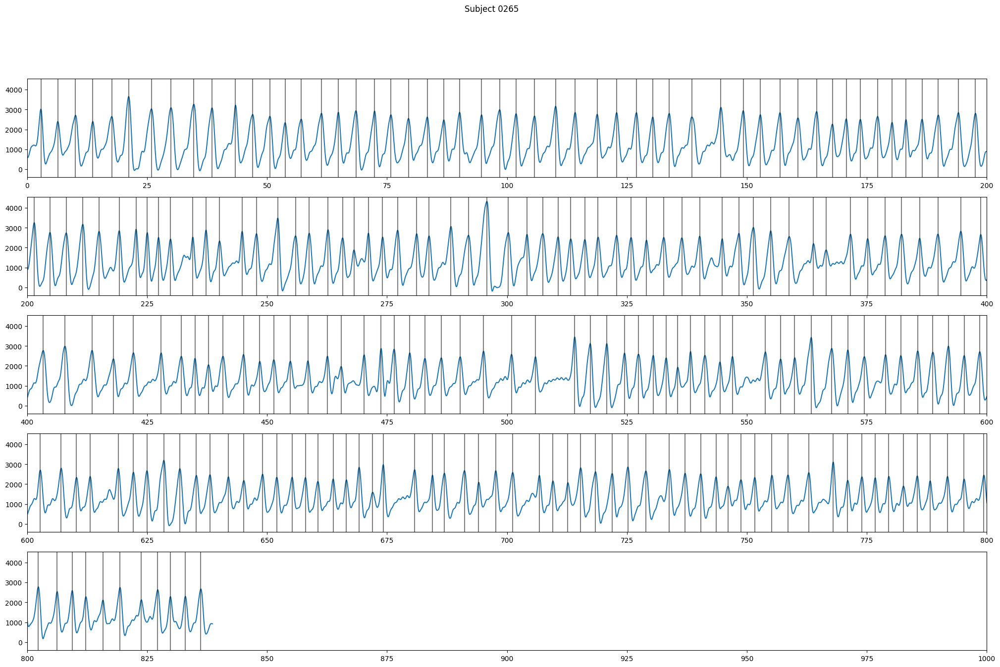

In [52]:
fig, ax = plt.subplots(nrows=5, ncols=1, figsize=(25, 15))
fig.suptitle(f'Subject {sub}')
for row in range(5):
    ax[row].plot(time, filtered)
    for peak in peaks_fmri:
        ax[row].axvline(peak/sfreq, color='black', alpha=0.5)
    ax[row].set_xlim(int(200*row),int(200*(row+1)))

plt.show()